In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import warnings
warnings.filterwarnings("ignore")

In [2]:
warnings.filterwarnings('ignore')
data = pd.read_csv(r"C:\Users\Mridul Mahajan\Desktop\ML Dataset\data.csv")
dataset_by_year = pd.read_csv(r"C:\Users\Mridul Mahajan\Desktop\ML Dataset\data_by_year.csv")
dataset_by_genres = pd.read_csv(r"C:\Users\Mridul Mahajan\Desktop\ML Dataset\data_by_genres.csv")


In [3]:
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [4]:
dataset_by_year.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [5]:
dataset_by_genres.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [7]:
dataset_by_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [8]:
dataset_by_genres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


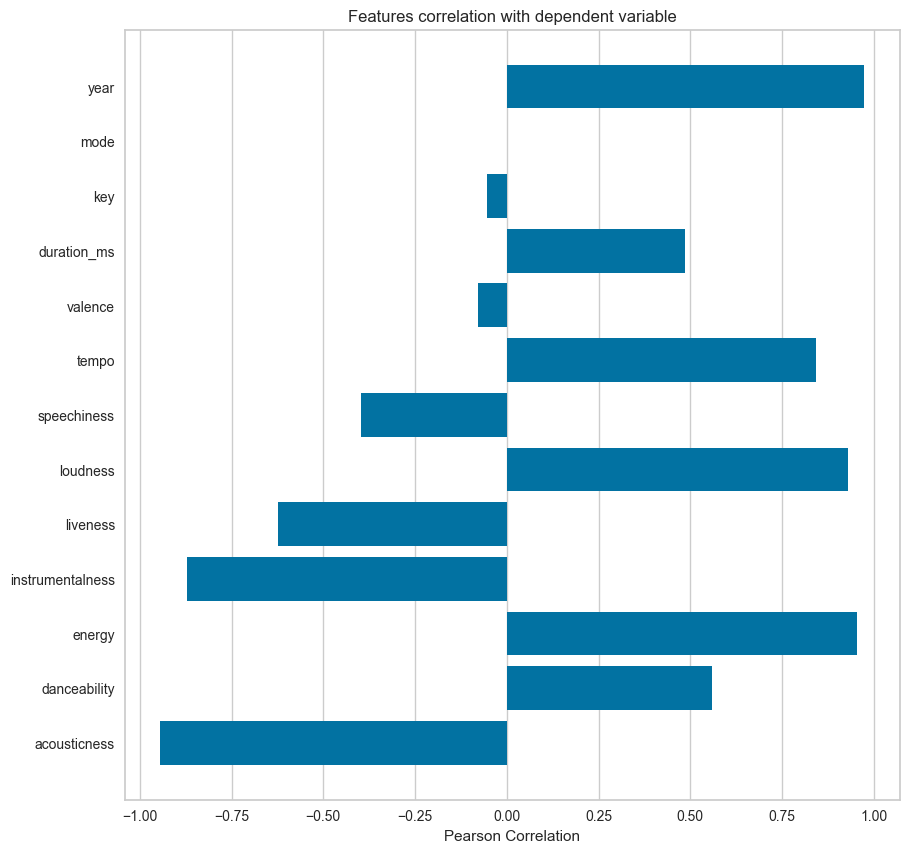

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [9]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from yellowbrick.target import FeatureCorrelation

# Define the list of feature names
feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
                 'liveness', 'loudness', 'speechiness', 'tempo', 'valence',
                 'duration_ms', 'key', 'mode', 'year']

# Extract features (X) and target (y) from your dataset
X, y = dataset_by_year[feature_names], dataset_by_year['popularity']

# Create an array of feature labels
features = np.array(feature_names)

# Instantiate the FeatureCorrelation visualizer
visualizer = FeatureCorrelation(labels=features)

# Set the figure size
plt.rcParams['figure.figsize'] = (10, 10)

# Fit the data to the visualizer
visualizer.fit(X, y)

# Display the correlation matrix visualization
visualizer.show()


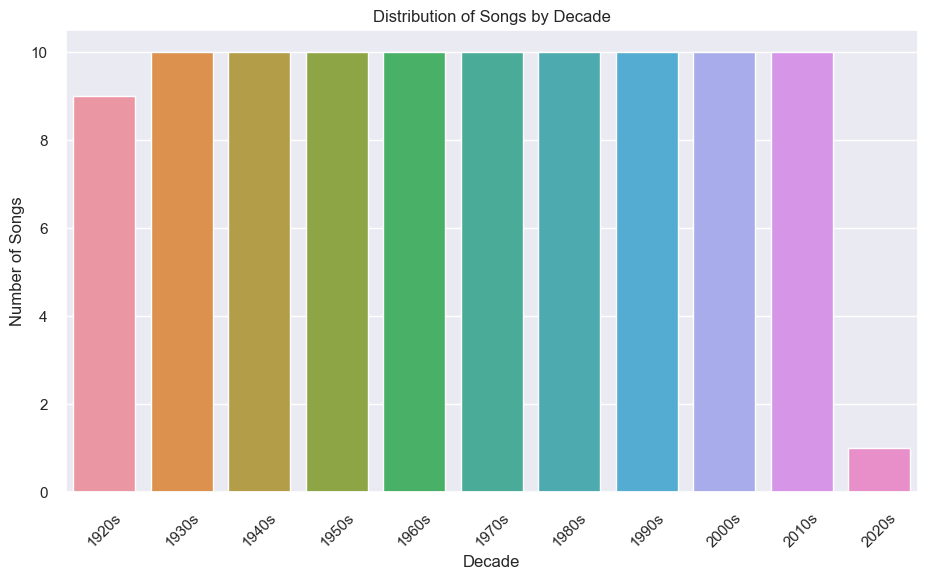

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame 'data' with a 'year' column containing the release year of songs

# Define a function to categorize years into decades
def get_decade(year):
    period_start = int(year / 10) * 10
    decade = '{}s'.format(period_start)
    return decade

# Apply the 'get_decade' function to create a new 'decade' column
dataset_by_year['decade'] = dataset_by_year['year'].apply(get_decade)

# Count the occurrences of each decade and sort them
decade_counts = dataset_by_year['decade'].value_counts().sort_index()

# Set the Seaborn figure size for the countplot
sns.set(rc={'figure.figsize': (11, 6)})

# Create a countplot to visualize the distribution of songs across decades
sns.countplot(data=dataset_by_year, x='decade', order=decade_counts.index)

# Customize the plot's labels and title
plt.xlabel('Decade')
plt.ylabel('Number of Songs')
plt.title('Distribution of Songs by Decade')

# Rotate x-axis labels for better readability (optional)
plt.xticks(rotation=45)

# Show the plot
plt.show()


In [11]:
# Import necessary libraries
import plotly.express as px

# Define the list of sound features to visualize
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']

# Create a line plot for each sound feature over the years
fig = px.line(dataset_by_year, x='year', y=sound_features)

# Customize the appearance of the plot (optional)
fig.update_layout(
    title="Sound Features Over the Years",
    xaxis_title="Year",
    yaxis_title="Sound Feature Value",
    legend_title="Sound Feature",
    hovermode="x unified",  # Display hover information for all lines at once
    template="plotly_dark"  # Choose a dark theme for the plot
)

# Show the interactive plot in Colab
fig.show()


In [12]:
import pandas as pd
import plotly.express as px

# Assuming you have a DataFrame named 'genre_data' with columns: 'genres', 'popularity', 'valence', 'energy', 'danceability', 'acousticness'

# Step 1: Get the top 10 genres based on popularity
top10_genres = dataset_by_genres.nlargest(10, 'popularity')

# Step 2: Create a bar chart using Plotly Express
# - 'x' specifies the x-axis values, which are genre names
# - 'y' specifies the y-axis values, which are a list of columns to plot ('valence', 'energy', 'danceability', 'acousticness')
# - 'barmode' is set to 'group' to create grouped bars for each genre
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')

# Step 3: Display the bar chart
fig.show()


In [13]:
# Import necessary libraries
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np
import plotly.express as px

# Create a pipeline for K-Means clustering
cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),    # Standardize features
    ('kmeans', KMeans(n_clusters=10))  # Apply K-Means clustering with 10 clusters
])

# Select numeric features for clustering
X = dataset_by_genres.select_dtypes(np.number)

# Fit the clustering pipeline to the data
cluster_pipeline.fit(X)

# Assign cluster labels to the original data
dataset_by_genres['cluster'] = cluster_pipeline.predict(X)

# Create a pipeline for t-SNE dimensionality reduction
tsne_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize features
    ('tsne', TSNE(n_components=2, verbose=1))  # Apply t-SNE with 2 components
])

# Perform t-SNE on the data
genre_embedding = tsne_pipeline.fit_transform(X)

# Create a DataFrame for the t-SNE results
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = dataset_by_genres['genres']
projection['cluster'] = dataset_by_genres['cluster']

# Create a scatter plot to visualize the clusters
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres']
)

# Show the plot
fig.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.009s...
[t-SNE] Computed neighbors for 2973 samples in 0.230s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106277
[t-SNE] KL divergence after 1000 iterations: 1.393068


In [14]:
# Import necessary libraries
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

# Define a pipeline for song clustering
song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize the data
    ('kmeans', KMeans(n_clusters=20, verbose=False))  # Perform K-Means clustering
], verbose=False)

# Select numerical features from the dataset (assuming 'data' is your DataFrame)
X = data.select_dtypes(np.number)
number_cols = list(X.columns)

# Fit the clustering pipeline to the data
song_cluster_pipeline.fit(X)

# Predict cluster labels for each song
song_cluster_labels = song_cluster_pipeline.predict(X)

# Add the cluster labels to the original data
data['cluster_label'] = song_cluster_labels

# Visualize the clusters using PCA
pca_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize the data
    ('PCA', PCA(n_components=2))  # Apply PCA for dimensionality reduction to 2 components
])

# Perform PCA and transform the data into a 2D space
song_embedding = pca_pipeline.fit_transform(X)

# Create a DataFrame to store the PCA results and cluster labels
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']  # Assuming 'name' is the song title column
projection['cluster'] = data['cluster_label']  # Add the cluster labels

# Create a scatter plot to visualize the clusters
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()


In [15]:
warnings.filterwarnings('ignore')
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
import numpy as np
from scipy.spatial.distance import cdist
import pandas as pd
from sklearn.preprocessing import StandardScaler

# Initialize Spotify API
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="ae657aff404c454fae20f1fc6ea75a60", client_secret="42a3faab44c240149ac49a5c6d28ea89"))

# Function to fetch song data by name and year
def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q='track:"{} year:{}'.format(name, year), limit=1)
    
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['artist'] = [name]
    song_data['release_date'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

# Define a list of numeric columns
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

# Function to get song data by name and year
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    except IndexError:
        return find_song(song['name'], song['year'])

# Function to calculate the mean vector of a list of songs
def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

# Function to recommend songs based on a list of seed songs
def recommend_songs(seed_songs, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_center = get_mean_vector(seed_songs, spotify_data)
    
    # Scale the data using StandardScaler
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    
    # Calculate cosine similarity
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin([song['name'] for song in seed_songs])]
    return rec_songs[metadata_cols].to_dict(orient='records')

# Example usage
seed_songs = [
    {'name': 'Come As You Are', 'year': 1991},
    {'name': 'Smells Like Teen Spirit', 'year': 1991},
    {'name': 'Lithium', 'year': 1992},
    {'name': 'All Apologies', 'year': 1993},
    {'name': 'Stay Away', 'year': 1993}
]

# Replace 'data' with your actual Spotify data DataFrame
recommended_songs = recommend_songs(seed_songs, data)

# Print recommended songs neatly
for song in recommended_songs:
    print(f"Song Name: {song['name']}")
    print(f"Year: {song['year']}")
    print(f"Artists: {song['artists']}")
    print("=" * 30)  # Separator line

Song Name: Hanging By A Moment
Year: 2000
Artists: ['Lifehouse']
Song Name: Kiss Me
Year: 1997
Artists: ['Sixpence None The Richer']
Song Name: Breakfast At Tiffany's
Year: 1995
Artists: ['Deep Blue Something']
Song Name: Otherside
Year: 1999
Artists: ['Red Hot Chili Peppers']
Song Name: It's Not Living (If It's Not With You)
Year: 2018
Artists: ['The 1975']
Song Name: No Excuses
Year: 1994
Artists: ['Alice In Chains']
Song Name: Wherever You Will Go
Year: 2001
Artists: ['The Calling']
Song Name: Ballbreaker
Year: 1995
Artists: ['AC/DC']
Song Name: Runaway (U & I)
Year: 2015
Artists: ['Galantis']
Song Name: Club Can't Handle Me (feat. David Guetta)
Year: 2010
Artists: ['Flo Rida', 'David Guetta']
